# Wzmacnianie

Drzewa decyzyjne mogą być używane do uczenia prostych modeli typu "if-else". Wystarczająco głębokie drzewo może wyrazić dowolną relację między etykietami a cechami. Prowadzi to jednak do tego, że węzły w głębokich drzewach są dopasowywane do coraz mniejszych zbiorów danych, czego rezultatem może być słaba generalizacja.

Las losowy rozwiązuje ten problem poprzez użycie losowości: budowanych jest kilka drzew, a ich wyniki są uśrednione. Do poprawnego działania wymagane jest, by każde z drzew dobrze dopasowało się do danych (dlatego często pozwalamy na over-fitting) oraz by były różne, co zapewnia użycie losowości w procesie tworzenia drzew.

W idealnym scenariuszu poszczególne klasyfikatory popełniają błędy na różnych przykładach, dzięki czemu razem są dokładniejsze niż pojedyncze drzewo.

## Wzmacnianie Słabych Klasyfikatorów



Rozważmy przypadek, w którym pojedyncze klasyfikatory są niewiele lepsze od przypadkowego zgadywania. Będziemy je nazywać _słabymi uczniami_.

Przeważnie ich połączenie nie da satysfakcjonującego klasyfikatora ze względu na korelacje między nimi, a przez to nakładanie się ich błędu. Wzmacnianie klasyfikatorów zaczęło się od teoretycznego pytania::

> Czy możliwe jest połączenie słabych klasyfikatorów (tylko nieznacznie lepszych od losowego zgadywania), by otrzymać klasyfikator o dowolnie małym błędzie?

Jak zobaczymy, odpowiedź jest twierdząca. Główną intuicją jest to, że nie możemy po prostu użyć losowości i mieć nadzieję, że słabe klasyfikatory będą wystarczająco niezależne, aby obniżyć ogólny błąd, jak to miało miejsce w przypadku lasów losowych. Zamiast tego, zbudujemy docelowy model sekwencyjnie. Każdy kolejny klasyfikator będzie szkolony, aby poprawić wynik klasyfikatorów dodanych dotychczas. Przez zmuszenie klasyfikatorów do korygowania błędów popełnionych przez poprzednie, możemy obniżyć ogólny błąd treningowy.

W związku z tym, wzmacnianie nie ma na celu over-fittingu i redukcji wariancji klasyfikatora, lecz modelowanie złożonych granic decyzyjnych, gdy dostępne klasyfikatory mogą produkować tylko te proste. Jednakże, okazuje się, że wzmacnianie prowadzi do powstawania modeli, które dobrze się generalizują.

## Wzmacnianie dla metody najmniejszych kwadratów



W tym rozdziale zostanie zaprezentowane użycie wzmacniania, kiedy błąd mierzony jest metodą najmniejszych kwadratów.
Model po $T$ rundach boostingu będzie zbiorem słabych uczniów (prostych regresorów) $f_t(x)$, gdzie każdy z nich brany jest z wagą $\alpha_t$: 

$$
F_T(x) = \sum_{t=1}^T \alpha_t f_T(x).
$$

Błąd na danych testowych po $T$ rundach wynosi:

$$
L_T = \sum_{i=1}^N \left(y^i - F_T(x^i)\right)^2.
$$

Przepiszmy powyższy wzór, by podkreślić kontrybucję $T$-tego klasyfikatora:

$$
\begin{align*}
L_T &= \sum_{i=1}^N \left(y^i - F_T(x^i)\right)^2 \\
    &= \sum_{i=1}^N \left(y^i - \sum_{t=1}^T \alpha_t f_t(x^i)\right)^2 \\ 
    &= \sum_{i=1}^N \left(y^i - \sum_{t=1}^{T-1} \alpha_t f_t(x^i) - \alpha_T f_T(x^i) \right)^2 \\
    &= \sum_{i=1}^N \left((y^i - F_{T-1}(x^i)) - \alpha_T f_T(x^i)\right)^2 \\
    &= \sum_{i=1}^N \left(r_T^i - \alpha_T f_T(x^i)\right)^2
\end{align*}
$$

gdzie $r_T^i = (y^i - F_{T-1}(x^i))$ oraz $r_0^i = y^i$.

Łatwo zauważyć, że w tym przypadku wzmacnianie będzie polegało na wielokrotnym dopasowywaniu się do reszt z poprzednich modeli.

### Przykład



Poniżej znajduje się przykład wzmacniania dla lekko zaburzonej funkcji $sin(x)$:

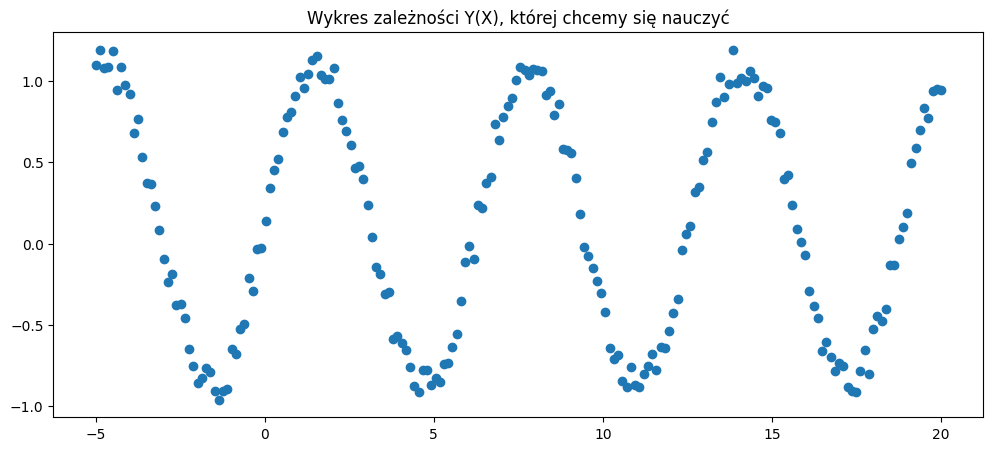

In [1]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np

plt.rcParams["animation.html"] = "jshtml"

X = np.linspace(-5, 20, 200)
Y = np.sin(X)
Y -= np.mean(Y)

# Zaburzenie funkcji sin(X)
Y += np.random.rand(200) / 4

plt.figure(figsize=(12, 5))
plt.title("Wykres zależności Y(X), której chcemy się nauczyć")
plt.scatter(X, Y)
plt.show()

In [2]:
def plot_regressor(X, r, f_t, X_plot, final_preds, t):
    plt.figure(figsize=(16, 2))
    plt.subplot(1, 2, 1)
    plt.scatter(X, r, label="reszty")
    plt.ylim(-1.2, 1.5)
    plt.plot(X_plot, f_t.predict(X_plot[:, None]), label="słaby regresor", color="r")
    plt.title(f"Regresor w rundzie {t+1}")
    plt.legend(loc="upper left")

    plt.subplot(1, 2, 2)
    plt.scatter(X, Y, label="prawdziwe wartości")
    plt.ylim(-1.2, 1.5)
    plt.plot(X_plot, final_preds, label="wzmocniony regresor", color="r")
    plt.title(f"Suma regresorów w rundzie {t}")
    plt.legend(loc="upper left")

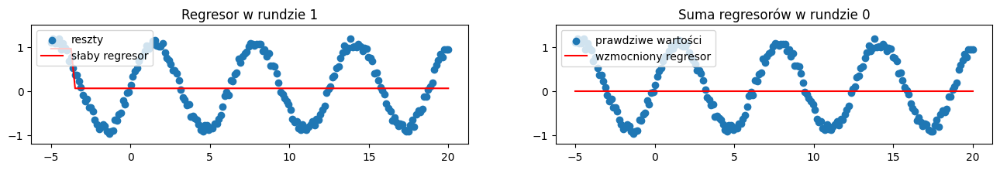

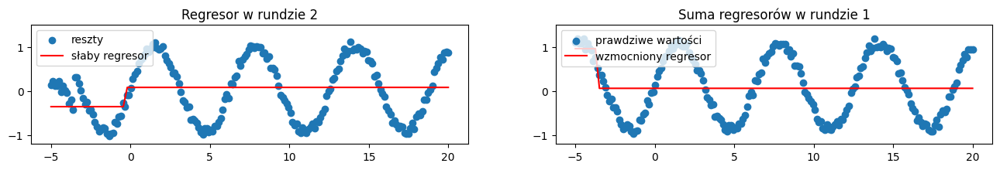

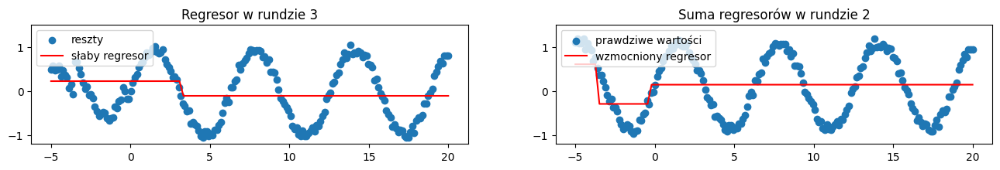

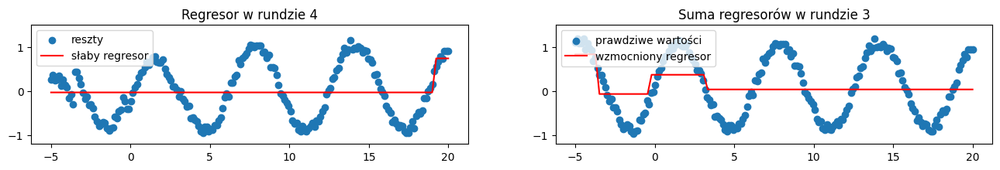

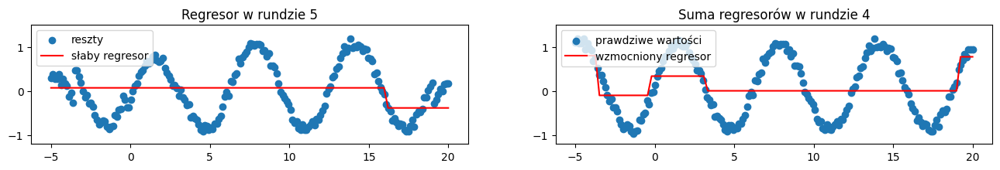

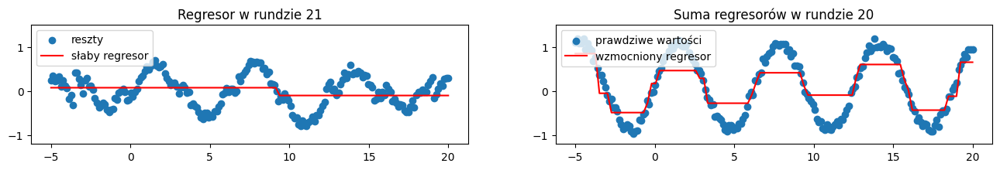

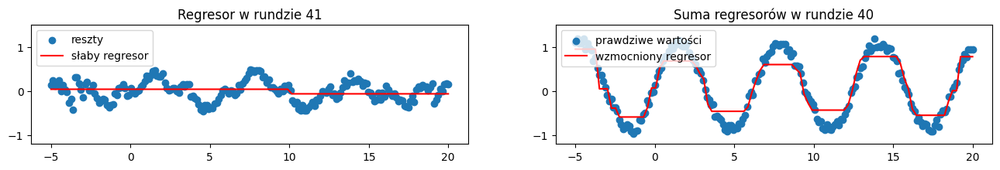

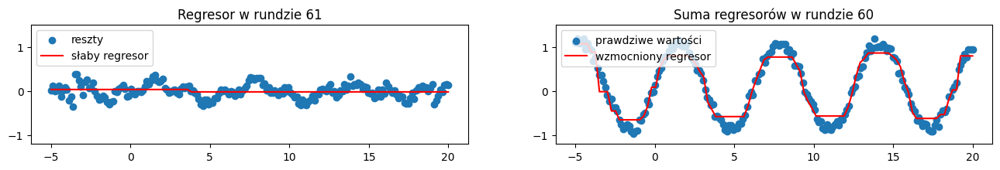

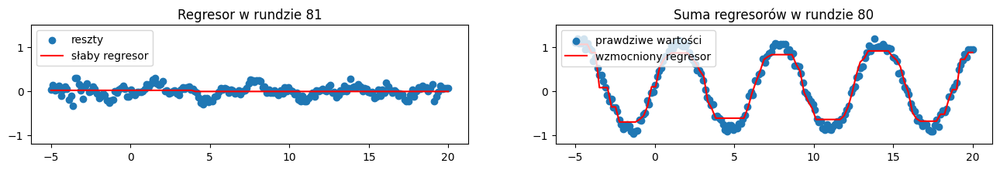

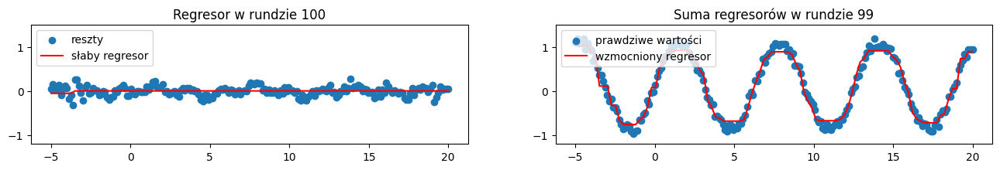

In [3]:
import sklearn.tree

T = 100
X_plot = np.linspace(X.min(), X.max(), 100)
final_preds = np.zeros_like(X_plot)

r = Y
for t in range(T):
    f_t = sklearn.tree.DecisionTreeRegressor(criterion="squared_error", max_depth=1).fit(X[:, None], r)

    if t % 20 == 0 or t < 5:
        plot_regressor(X, r, f_t, X_plot, final_preds, t)

    r = r - f_t.predict(X[:, None])
    final_preds = final_preds + f_t.predict(X_plot[:, None])

plot_regressor(X, r, f_t, X_plot, final_preds, t)

## Generalizing Boosting to Other Loss Functions

**NB** Gradient Boosting is optional and it is not required to understand XGBoost below.

We were able to easily write a boosting algorithm for regression, because we already had decision trees which minimize the MSE loss. However, other loss functions, such as the negative log-likelihood from logistic regression, or robust regression losses such as Huber do not necessarily allow easy learning of weak learners that optimize them.

Suppose for a moment that our goal is to learn the values that our model should return at the training  data points. In other words, we treat $F$ as a vector 
$$
F = [F^1, F^2, ..., F^N]
$$
where $F_i$ is the desired output of our model for training sample $x^i$, and we keep using the upper index for sample enumeration.

Suppose we wish to minimize our loss function over the vector $F$:
$$
\min_F \frac{1}{N} \sum_{i=1}^N L(Y^i, F^i).
$$

To develop intuitions about the _gradient boosting method_ we will not simply set $F^i = Y^i$, but instead observe what gradient descent would do to find the vector $F$. The algorithm would work as follows:
1. Set the initial vector $F_0 = 0$  (i.e., $F_0$ is a vector of values associated with all data samples, i.e. a vector of $N$ zeros).
2. For $t$ in $1...T$:
    1. Compute the derivative $g_t = \frac{\partial L}{\partial F}$
    2. Set $F_t = F_{t-1} - \alpha_t g_t$

Thus we express the vector of model outputs $F$ by a sum of gradients of the loss function.

Gradient Boosting will approximate this procedure, however it will not store a vector of model responses, but it will compute them using a model expressed as a sum of learners:

1. $F_0(x) = 0$ the first model is empty and returns $0$ for all $x$.
2. For $t$ in $1...T$:
    1. Find an approximation to the derivative $\frac{\partial L}{\partial F}$:
        1. Compute the vector of derivatives of the loss with respect to model outputs on all training samples:
            $$ 
            r^i_t = \left[\frac{\partial L\left(y^i, F_{t-1}(x^i)\right)}{\partial F_{t-1}(x^i)}\right]
            $$
        2. Fit a regressor $f_t(x)$ to the vector of derivatives $r_t$: it will approximate the gradient on data samples.
    2. Set $F_t(x) = F_{t-1}(x) + \alpha_t f_t(x)$

Notice that gradient boosting is just an approximation to fitting a table of model outputs: since the model outputs for different samples are not independent (they are all computed by a model) we cannot arbitrarily change them. Thus the best we can do is to find an addition to the model, which would approximate the gradient! However, a table function doesn't generalize. Our boosted model does!

Please note, that for the square loss $\frac{\partial(y-f)^2}{\partial f} = 2(y-f)$ which means that gradient boosting applied to a mean squares criterion simply fits the regressor to the residuals from the previous stage, recovering the example above.

In the special case when the weak learner is a decision tree, we can fold the constants $\alpha$ into the tree. A tree assigns samples to leaf nodes, then returns the value associated with a given leaf. Rather than multiplying the values in all leaves by a single $\alpha$, we can re-learn the value in each leaf. In particular, assume that the tree fitted to gradients 
$r_t$ assigned each sample to one of $M$ leaves denoted $R_{t1},...,R_{tM}$, each returning the value $\omega_{tj}$. Rewrite the loss function at round $t$ as:

$$
\begin{split}
L_t &= \sum_i L(Y^i, F_{t-1}(x^i) + f_t(x^i)) \\
&= \sum_{j=1}^{M}\sum_{i\in R_{tj}}L(Y^i, F_{t-1}(x^i) + f_t(x^i)) \\
&=\sum_{j=1}^{M}\sum_{i\in R_{tj}}L(Y^i, F_{t-1}(x^i) + \omega_{tj}) 
\end{split}
$$

It is then usually easy to optimally fit the leaf values $\omega_{tj}$.

## Uczenie się okręgu


W tym podrozdziale spróbujemy, przy pomocy wzmacniania, nauczyć się okręgu. 

In [4]:
def plot_data(X, Y):
    plt.scatter(
        X[Y == True, 0], X[Y == True, 1], label="True", color=(0.2, 0.5, 0.7), edgecolors="white", linewidth=0.5
    )
    plt.scatter(
        X[Y == False, 0], X[Y == False, 1], label="False", color=(0.9, 0.1, 0.1), edgecolors="white", linewidth=0.5
    )
    plt.axis("square")
    plt.xlim(X[:, 0].min() - 0.1, X[:, 0].max() + 0.1)
    plt.ylim(X[:, 1].min() - 0.1, X[:, 1].max() + 0.1)
    plt.legend(loc="upper right")

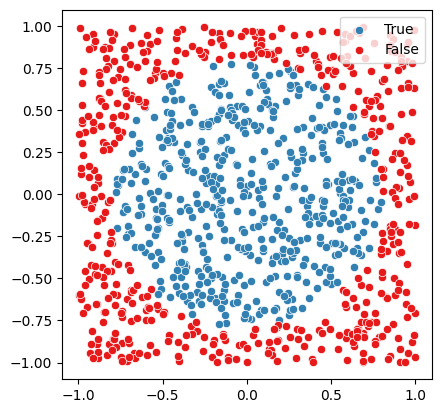

In [5]:
X = np.random.rand(1000, 2) * 2 - 1
y = (X**2).sum(axis=1) < (2 / np.pi)

plot_data(X, y)

First the impossible one:
    
    Suppose for a moment that our goal is to learn the values that our model should return at the training  data points. In other words, we treat $F$ as a vector 
$$
F = [F^1, F^2, ..., F^N]
$$
where $F_i$ is the desired output of our model for training sample $x^i$, and we keep using the upper index for sample enumeration.

Suppose we wish to minimize our loss function over the vector $F$:
$$
\min_F \frac{1}{N} \sum_{i=1}^N L(Y^i, F^i).
$$

To develop intuitions about the _gradient boosting method_ we will not simply set $F^i = Y^i$, but instead observe what gradient descent would do to find the vector $F$. The algorithm would work as follows:
1. Set the initial vector $F_0 = 0$  (i.e., $F_0$ is a vector of values associated with all data samples, i.e. a vector of $N$ zeros).
2. For $t$ in $1...T$:
    1. Compute the derivative $g_t = \frac{\partial L}{\partial F}$
    2. Set $F_t = F_{t-1} - \alpha_t g_t$

Thus we express the vector of model outputs $F$ by a sum of gradients of the loss function.


In [6]:
def mse_loss(y, p):
    return np.square(y - p).mean()


def mse_loss_gradient(y, p):
    return -2 / len(y) * (y - p)

0.48


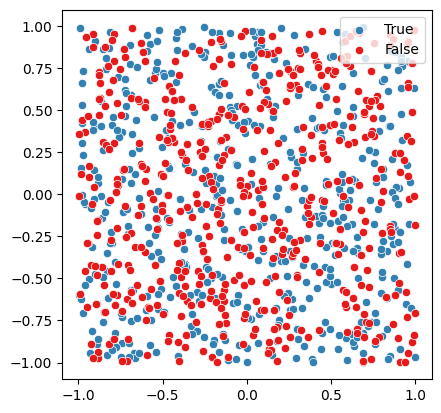

In [7]:
F = np.random.uniform(size=y.shape)

print(((F > 0.5) == y).mean())

plot_data(X, F > 0.5)

In [8]:
def learn_circle_anim(F, F_update, frames, steps_per_frame=1):
    fig, ax = plt.subplots()

    scatter_true = ax.scatter([], [], label="True", color=(0.2, 0.5, 0.7), edgecolors="white", linewidth=0.5)
    scatter_false = ax.scatter([], [], label="False", color=(0.9, 0.1, 0.1), edgecolors="white", linewidth=0.5)
    text = ax.text(0.6, 1.15, "")

    plt.axis("square")
    plt.xlim(X[:, 0].min() - 0.1, X[:, 0].max() + 0.1)
    plt.ylim(X[:, 1].min() - 0.1, X[:, 1].max() + 0.1)
    plt.legend(loc="upper right")

    def init():
        return ()

    first_run = True

    def update(frame):
        nonlocal F, first_run
        if first_run:
            first_run = False
        else:
            for _ in range(steps_per_frame):
                F[:] = F_update(F)

        Y = F > 0.5
        acc = ((F > 0.5) == y).mean()

        scatter_true.set_offsets(X[Y == True])
        scatter_false.set_offsets(X[Y == False])
        text.set_text(f"Acc = {acc:.3f}")
        return scatter_true, scatter_false, text

    anim = animation.FuncAnimation(fig, update, frames=frames, init_func=init, interval=100, blit=True)
    plt.close(fig)
    return anim

In [11]:
def F_grad_update(alpha):
    def inner(F):
        f_t = -mse_loss_gradient(y, F)
        return F + alpha * f_t

    return inner


F = np.random.uniform(size=y.shape)
print(((F > 0.5) == y).mean())
learn_circle_anim(F, F_grad_update(15.0), 30)

0.502


In [82]:
def F_tree_const_alpha_update(alpha):
    def inner(F):
        r = -mse_loss_gradient(y, F)

        tree = sklearn.tree.DecisionTreeRegressor(criterion="squared_error", max_depth=1)
        tree.fit(X, r)
        f_t = tree.predict(X)

        return F + alpha * f_t

    return inner


F = np.random.uniform(size=y.shape)
print(((F > 0.5) == y).mean())
learn_circle_anim(F, F_tree_const_alpha_update(500.0), 100, 50)

0.508


In [85]:
ALPHA_SPACE = np.linspace(0.0, 600.0, 100)[1:]


def F_tree_best_alpha_update(F):
    r = -mse_loss_gradient(y, F)

    tree = sklearn.tree.DecisionTreeRegressor(criterion="squared_error", max_depth=1)
    tree.fit(X, r)
    f_t = tree.predict(X)

    mse_vals = np.asarray([mse_loss(y, F + alpha * f_t).mean() for alpha in ALPHA_SPACE])
    alpha_t = ALPHA_SPACE[np.argmin(mse_vals)]

    return F + alpha_t * f_t


F = np.random.uniform(size=y.shape)
print(((F > 0.5) == y).mean())
learn_circle_anim(F, F_tree_best_alpha_update, 100, 50)

0.49


## Uczenie się sfery


W tym podrozdziale spróbujemy, przy pomocy wzmacniania, nauczyć się sfery. 

In [13]:
import plotly.express as px

fig = px.scatter_3d(x=X[:, 0], y=X[:, 1], z=F, color=F, size_max=18, opacity=0.7)

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

## XGBoost

Gradient boosting introduced in the last section extended boosting to a variety of loss functions, but it still kept low requirements on the weak regressor: it was only required to be able to fit the gradient of the loss on training samples using a MSE criterion.

XGBoost is specialized to boosting decision trees. It allows optimizing different loss functions by directly growing trees that optimize them. It combines the following ideas:
- Loss functions are approximated using a Taylor expansion, thus to XGBoost they all look like quadratics.
- Regularization terms are added to the loss to promote small trees with smooth values in the leaves.
- Trees are greedily created, to minimize the training objective - the optimized loss is used directly in place of a purity or simple MSE critetion for split selection!

The XGBoost model assumes the following loss optimization objective:

$$
\mathcal{L} = \sum_i L\left(y^i, \sum_t f_t(x^i)\right) + \sum_t\Omega(f_t),
$$
where:
- $L$ is a loss function, e.g. cross-entropy or MSE
- $f_t$ is the tree learned during round $t$
- $\Omega$ is a tree penalty, $\Omega(f) = \gamma |f| + \lambda \frac{1}{2} \sum_{1}^{|f|}(\omega_j)^2$ with $|f|$ denoting the number of leaves in the tree $f$ and $\omega_j$ is the value returned by leaf $j$.

Thus XGBoost aims to create an ensemble of trees which minimize a given loss function, are small and have small $L_2$ norm of their values.

During round $t$ XGBoost greedily grows a tree to directly minimize the objective.

First, it replaces the loss $L$ for each data sample with a Taylor aproximation. After removing constant terms the objective during round $t$ becomes:

$$
\mathcal{\tilde{L}_t} = \sum_i\left[g_i f_t(x^i) + \frac{1}{2}h_if_t^2(x^i) \right] + \Omega(f_t),
$$
where $g_i, h_i$ are they Taylor expansion coefficients given by: $g_i = \left[\frac{\partial L(y^i, F(x^i))}{\partial{F(x^i)}}\right]_{F = F_{t-1}}$ and $h_i = \left[\frac{\partial^2 L(y^i, F(x^i))}{\partial(F(x^i))^2}\right]_{F = F_{t-1}}$.

Suppose that the tree added in round $t$ has $M$ leaves denoted $R_{t1},...,R_{tM}$. We can rewrite the loss as:
$$
\begin{split}
\mathcal{\tilde{L}_t} &= \sum_i\left[g_i f_t(x^i) + \frac{1}{2}h_if_t^2(x^i) \right] + \gamma M +\lambda\frac{1}{2}\sum_{j=1}^M \omega_j^2 \\
&= \sum_{j=1}^M\left[\left(\sum_{i\in R_{tj}}g_i\right)\omega_j + \frac{1}{2}\left(  \sum_{i\in R_{tj}}h_i + \lambda\right)\omega_j^2 \right] + \gamma M
\end{split}
$$

For each leaf, we can find its optimal value:
$$
\omega_j^* = -\frac{\sum_{i\in R_{tj}} g_i}{\sum_{i\in R_{tj}}(h_i + \lambda)}
$$

Plugging this optimal value into the loss gives us a score of the tree structure:
$$
\mathcal{\tilde{L}_t} -\frac{1}{2}\sum_{j=1}^M\frac{\left(\sum_{i\in R_{tj}} g_i\right)^2}{\sum_{i\in R_{tj}}(h_i + \lambda)} + \gamma M
$$

We can then perform a greedy search for tree splits, by using the above score as a split node quality.

XGBoost implements many further optimizations that enhance the quality of the ensembles:
1. Shrinkage: newly added weights are multipied by $\alpha<1$, which we can interpret as making smaller gradient steps.
2. Randomized tree building:
    * row subsampling: trees are built on subsets of training data
    * column subsampling: similarly to random forests, trees consider only a random subset of attributes
3. Distributed computations and collection of approximate leaf statistics, using sketching techniques. If you are interested, you should consider [dr Uznański's course](https://zapisy.ii.uni.wroc.pl/offer/723-algorithms-for-big-data/).

## Inne zastosowania boostingu

Boosting fits an ensemble of classifiers by sequentially learning models which correct mistakes of previous ones. Intuitively, models learned early on take care of the "broad picture", the general fit to the data, while the models learned at the later rounds "fill in the details". This intuition is used in cascaded object detectors.

The [Viola-Jones](https://en.wikipedia.org/wiki/Viola%E2%80%93Jones_object_detection_framework) face recognizer was one of the first that could be run in real time on digital cameras. Its task was to detect faces in an image. This task can be reduced to scoring each possible face location (rectangle in the image, given e.g. by the upper left and lower right corners). Since there are many possible locations to score, the classifier was designed to very quickly give up on non-prospective regions.

This was obtained using a cascaded architecture:
- the first classifier was made to reject the majority of regions, having a very low probability of rejecting a face
- the next classifier was slightly more precise, hence slower, but it was run much less often, it again had to reject maximally many non-faces, while keeping the face rejection probability very low.
- subsequent classifiers were again allowed to be larger, but due to the rejection of non-faces by previous stages they were run very infrequently.

Fast rejection of non-faces means that the classifiers must be extremely basic, and cheap to execute. In other words, they are weak learners. The Viola-Jones detector uses simple wavelet features, which compare the amount of ink in the white and dark regions:


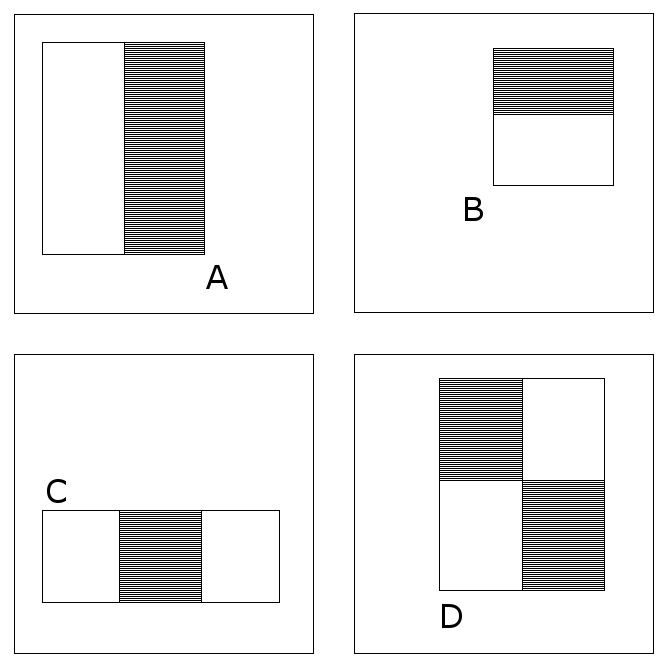

These features can be computed in constant time given an integral image (image containing cumulative sums over pixel values). Moreover, they do not require floating point arithmetics.

Early stages of the cascade used only a few features, nevertheless they were able to reject many non-faces, allowing larger tree-based classifiers where the features were used for splits.

We show below features used by first few stages, they intuitively react to the eye region and the nose:

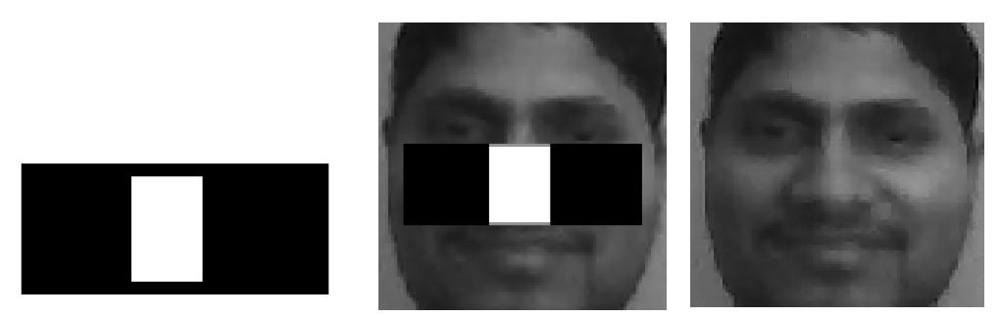
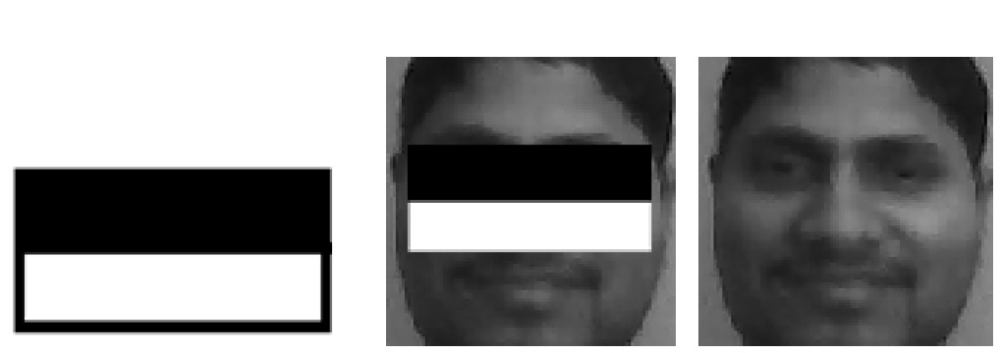

The Viola-Jones detector was trained using AdaBoost modified to support assymetrical errors: rejecting a face image was penalised more severely than keeping a non-face image.


## Podsumowanie

W tych notatkach zobaczyliśmy, jak można budować docelowy klasyfikator poprzez sekwencyjne dodawanie nowych klasyfikatorów, które mają poprawić działanie całego modelu.

Wzmacniane drzewa decyzyjne są potężnymi i wszechstronnie stosowanymi modelami. Popularne implementacje wzmacniania, takie jak XGBoost, a także nowsze CatBoost czy LightGBM, znalazły zastosowanie w zwycięskich rozwiązaniach wielu konkursów na platformie Kaggle.

## Dodatkowe materiały
- Murphy, rozdział 16.4
- [Elements of Statistical Learning](https://web.stanford.edu/~hastie/ElemStatLearn/), rozdział 10
- XGBoost [wstęp](https://xgboost.readthedocs.io/en/latest/tutorials/model.html), [prezentacja](https://web.archive.org/web/20200415044009/https://homes.cs.washington.edu/~tqchen/pdf/BoostedTree.pdf), oraz [praca](https://www.kdd.org/kdd2016/papers/files/rfp0697-chenAemb.pdf).